# QuTip Simulation: Qubit with Noise

Quantum Sensing Fundamentals \
Mid-term Assignment \
Alimurrijal Islamuddin - 2024021639

In [1]:
from IPython.display import Image
import os

filepath = os.getcwd()
def get_bloch_sphere(fname):
    return Image(filename=filepath+'/data/'+fname, width=400, height=300)

def get_signal_graph(fname):
    return Image(filename=filepath+'/data/'+fname, width=600, height=200)

Through this experiment, QuTip is used to perform several simulations of qubit, including Rabi simulation, T1 relaxometry, Ramsey simulation with decoherence, and Hahn-Echo simulation with decoherence. The dynamics of the qubit can be visualized through the evolution of its state vector on the Bloch sphere, while the measurement outcome, the probability to find qubit in the ground state $\ket{0}$ can be observed through the pulse sequence. In this simulation, the spin evolution and the corresponding probability distribution are compared under different conditions. However, this notebook focuses more on the pulse sequence of system and qubit's probability to be measured in the ground state.

### Rabi Simulation

Rabi oscillation describes the phenomenon in which a quantum wave packet, initialy in a ground state, is driven to an excited state by an external magnetic field and subsequently returns to its original state, completing a cyclic evolution. Through this simulation, Rabi oscillation is observed by eliminating the time-dependence in the Hamiltonian of the system, hence Rotating Wave Approximation (RWA) is applied to the system. The influence of $T_1$ is investigated in this simulation, which describes the time it takes for a qubit to return to its equilibrium state (aligned with the z-axis) after being disturbed. Physically, it corresponds to how the system loses energy to the environment, causing the qubit to decay towards the ground state. $T_1$ times is introduced to the system by setting the parameter relaxation rate $\gamma_-$ by the following relation:
$$ \gamma_- = \frac{1}{T_1}$$

#### 1.1 No relaxation, no dephasing

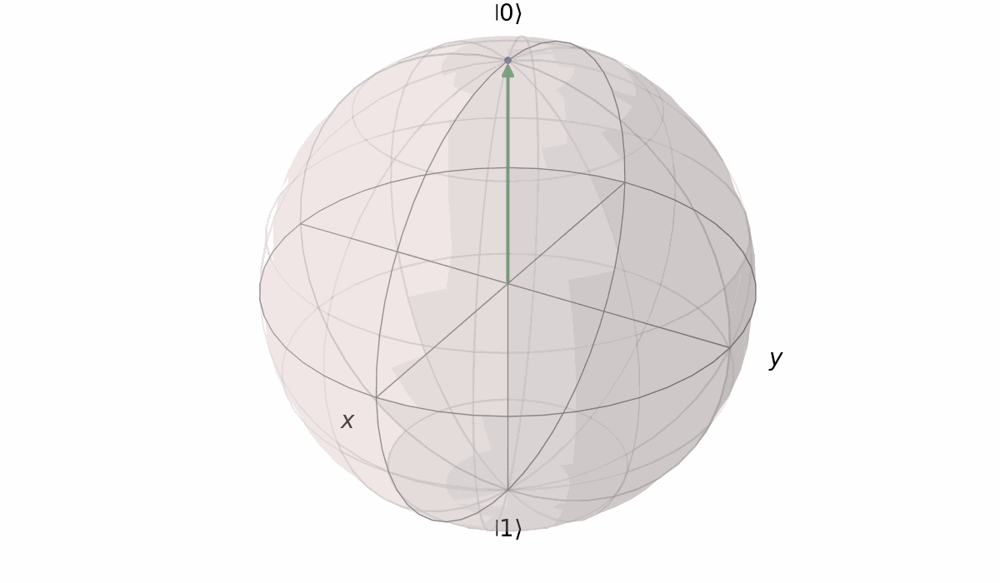

In [2]:
get_bloch_sphere('rabi_bloch_case_1.gif')

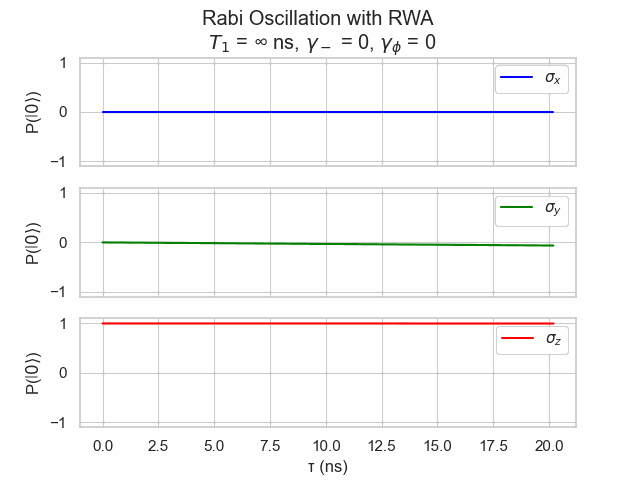

In [3]:
get_signal_graph('rabi_graph_case_1.gif')

#### 1.2 Fast $T_1$ times

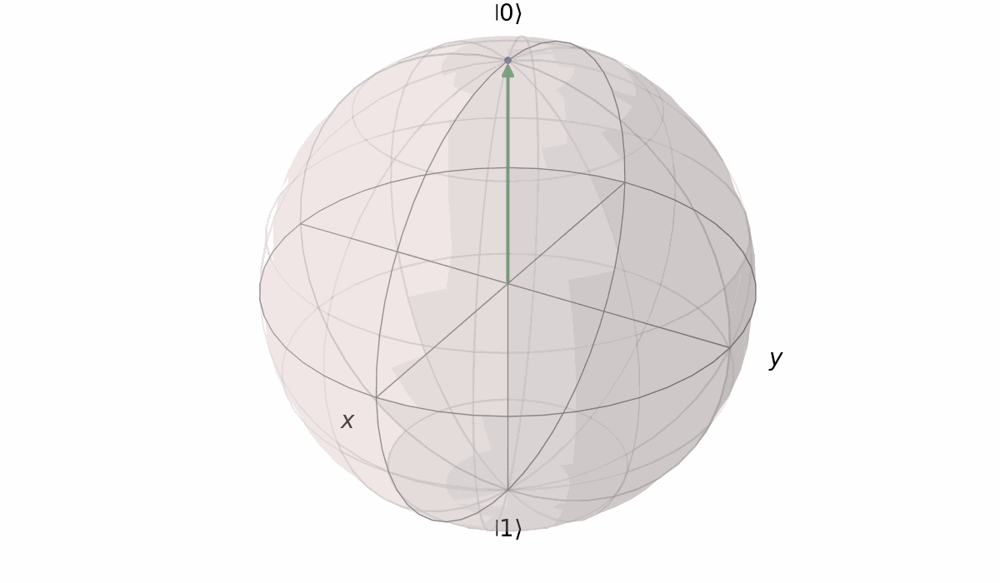

In [4]:
get_bloch_sphere('rabi_bloch_case_2.gif')

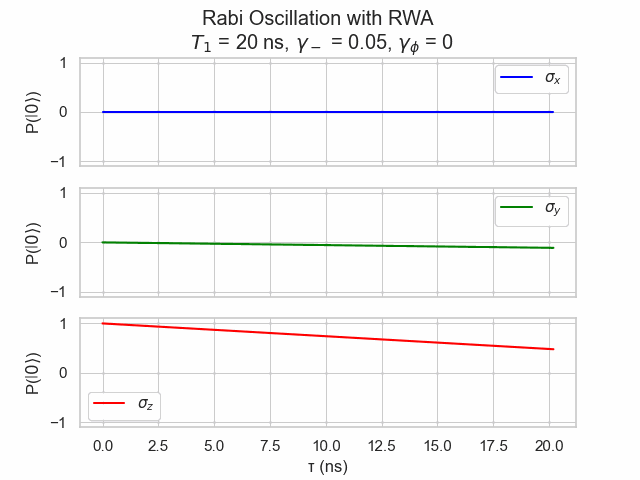

In [5]:
get_signal_graph('rabi_graph_case_2.gif')

#### 1.3 Moderate $T_1$ times

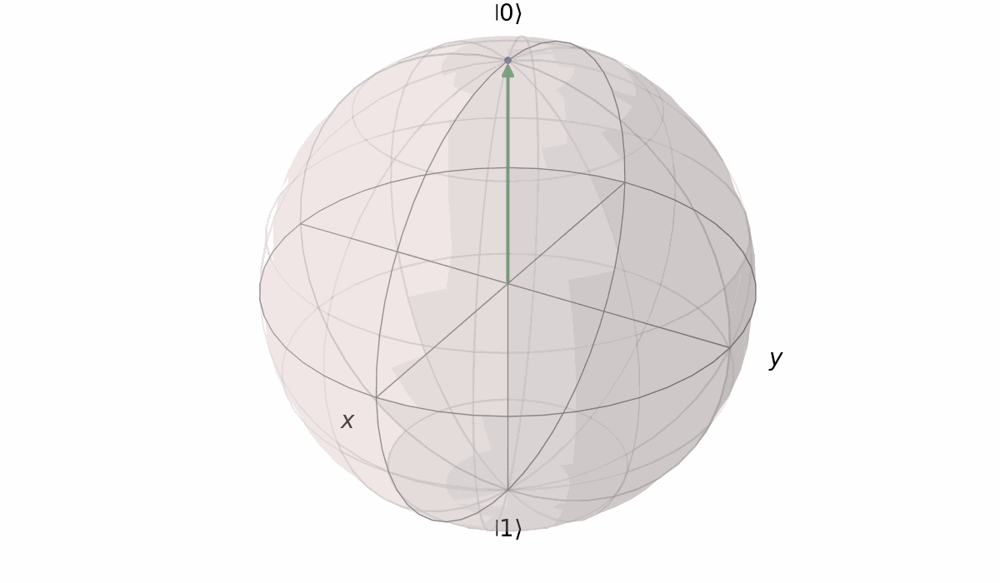

In [6]:
get_bloch_sphere('rabi_bloch_case_3.gif')

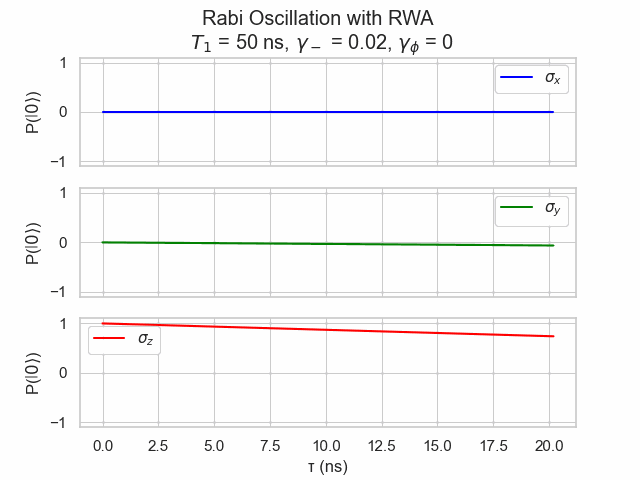

In [7]:
get_signal_graph('rabi_graph_case_3.gif')

#### 1.4 Long $T_1$ times

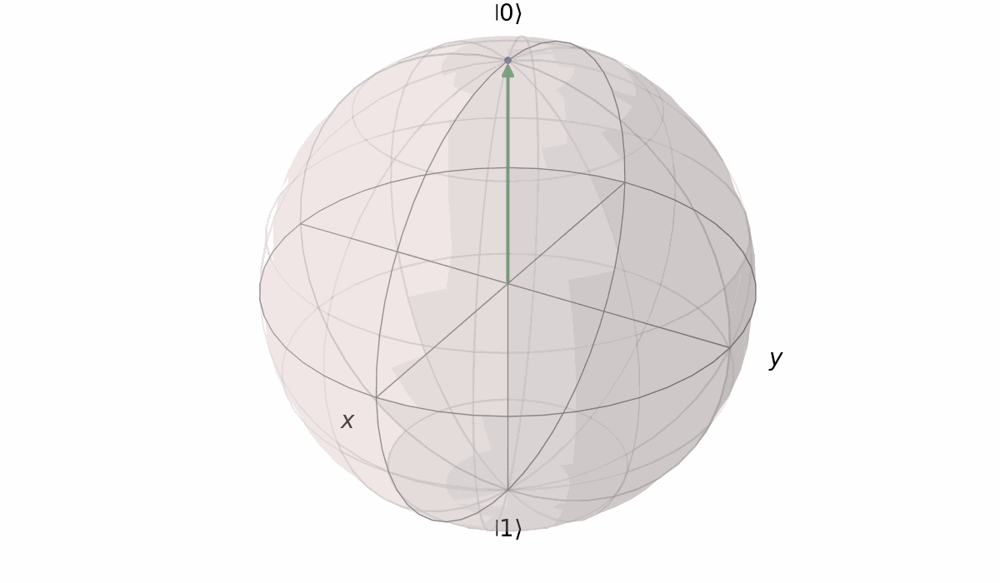

In [8]:
get_bloch_sphere('rabi_bloch_case_4.gif')

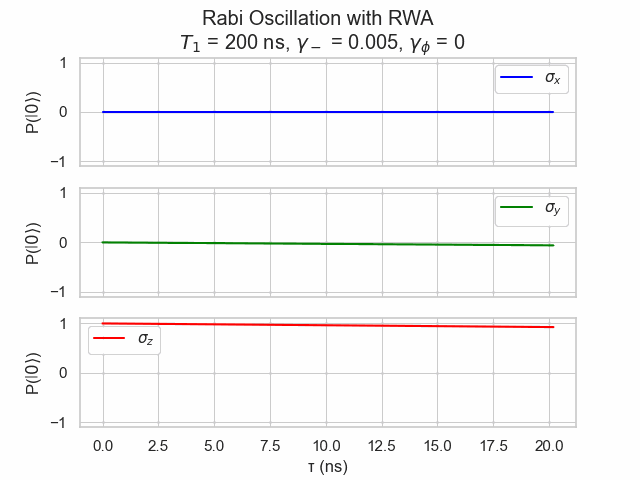

In [9]:
get_signal_graph('rabi_graph_case_4.gif')

In this case, $T_1$ times is set to be long (~200 ns), meaning the qubit retains its coherence much longer compared to the previous case, leading to the much slower decays.

#### 1.5 Very long $T_1$ times

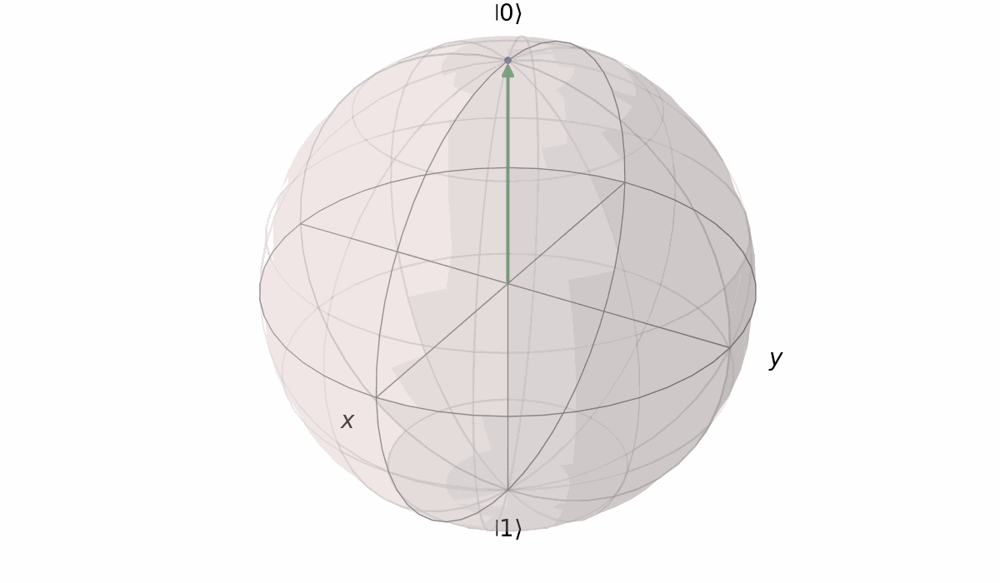

In [10]:
get_bloch_sphere('rabi_bloch_case_5.gif')

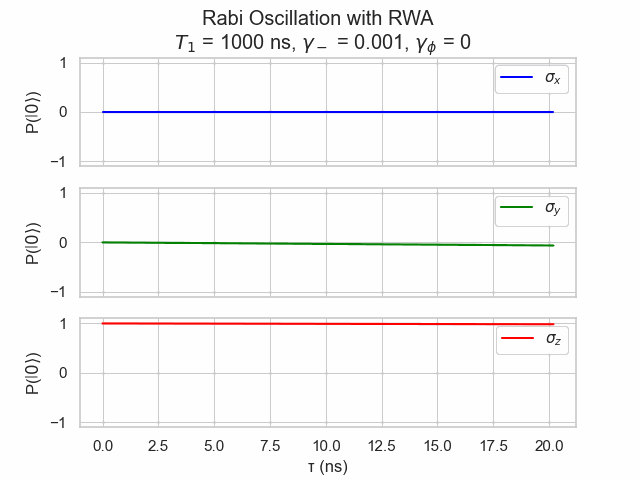

In [11]:
get_signal_graph('rabi_graph_case_5.gif')

#### 1.6 No relaxation, pure dephasing

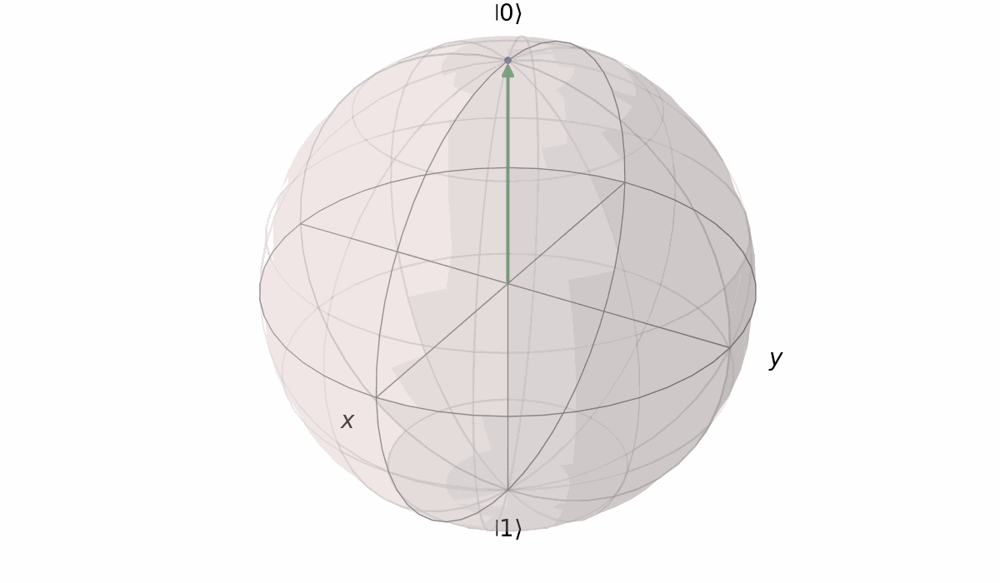

In [12]:
get_bloch_sphere('rabi_bloch_case_6.gif')

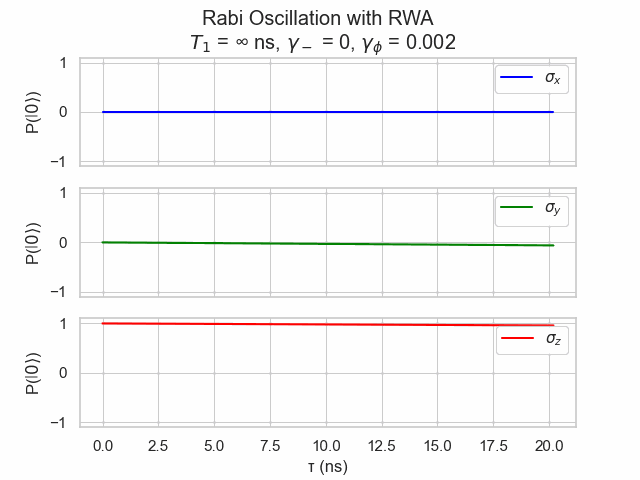

In [13]:
get_signal_graph('rabi_graph_case_6.gif')

Without relaxation and dephasing, the system is in perfect coherence, exhibits the ideal Rabi oscillations with no damping. As shown in the Bloch sphere in 1.1, the qubit evolves freely around the equator without experiencing any phase distortion. In this ideal case, the qubit will oscillate forever between the two states $\ket{0}$ and $\ket{1}$, with a frequency proportional to the drive strength (Rabi frequency).

By introducing the relaxation to the system, the amplitude of Rabi oscillations starts to decay over time. The dacay depends on the chosen $T_1$ times. A shorter $T_1$ times means the qubit will decay faster compared to the longer $T_1$ times. As shown in 1.2, 1.3, 1.4, and 1.5, the $T_1$ times are set to be around 20 ns, 50 ns, 200 ns, and 1000 ns respectively.

Among these values, shorter $T_1$ values shows a significant relaxation, causing rapid decay of the Rabi oscillations. As the $T_1$ increases, the system decays much longer and eventually reaches a steady state where the rate of excitation equals the rate of relaxation. In this state, the system does not oscillate anymore but settles into a constant population imbalance around 0.5. This indicates the system is in superposition.

The evolution of the Bloch sphere shows a perfect circular trajectory in ideal case. However, when the relaxation is introduced to the system, instead tracing a perfect circle, the Bloch vector spirals inward reducing its radius, reflecting reduced purity of the state and indicating the the system is in mixed state due to decoherence.

### T1 Relaxometry Simulation

T1 relaxometry is used to characterize the longitudinal relaxation time ($T_1$) of a quantum system, which describes the time it takes for the system to return to thermal equilibrium after being disturbed. In this simulation, T1 relaxometry is performed by assigning different $T_1$ times to investigate the influence of this parameter on the system's behavior.

#### 2.1 Short $T_1$ times

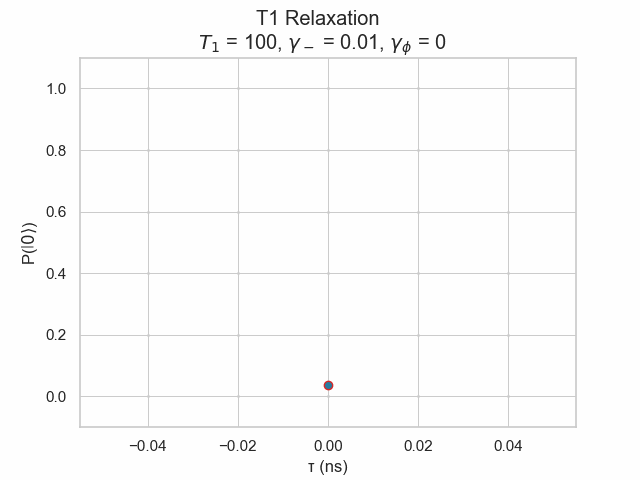

In [14]:
get_signal_graph('t1_graph_case_1.gif')

#### 2.2 Moderate $T_1$ times

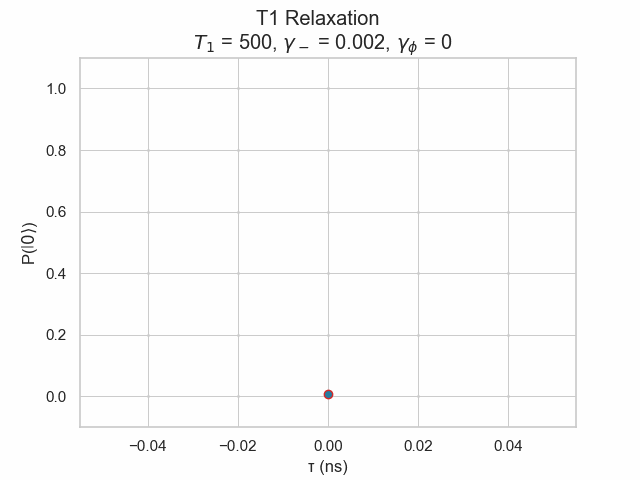

In [15]:
get_signal_graph('t1_graph_case_2.gif')

#### 2.3 Long $T_1$ times

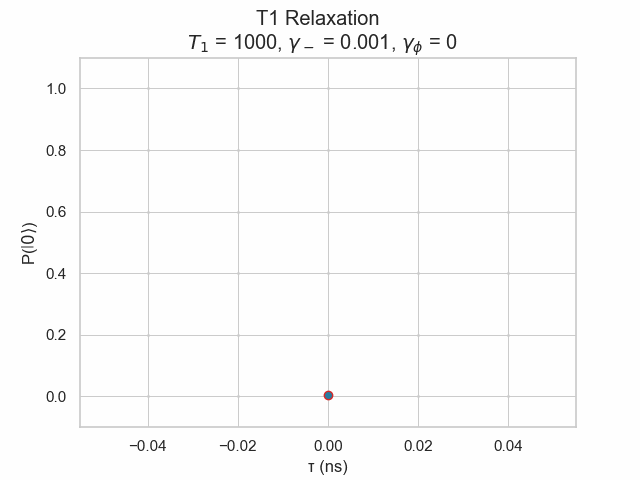

In [16]:
get_signal_graph('t1_graph_case_3.gif')

#### 2.4 Very long $T_1$ times

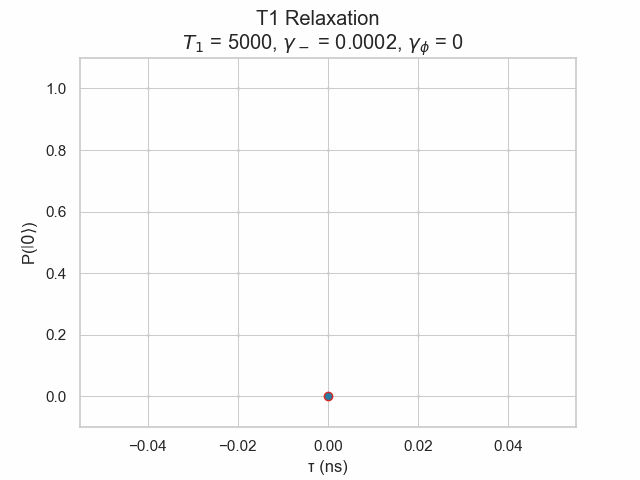

In [17]:
get_signal_graph('t1_graph_case_4.gif')

#### 2.5 Very short $T_1$ times

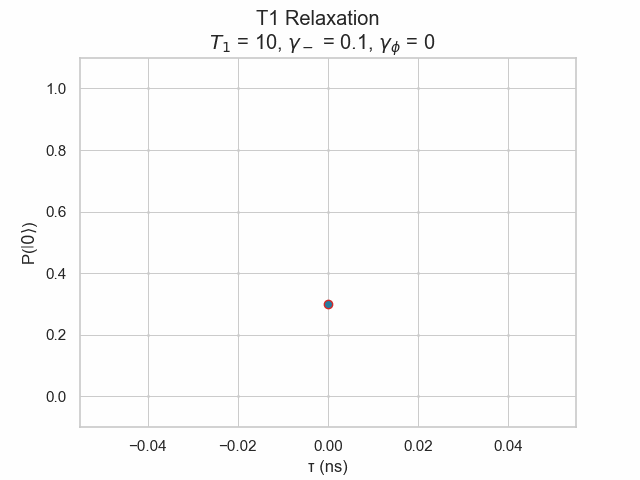

In [18]:
get_signal_graph('t1_graph_case_5.gif')

For systems with short $T_1$ times in 2.1 and 2.5, the ground state probability decays rapidly, indicating that the qubit loses its energy to the environment and transitions to a mixed state where the probability of being in the ground state stabilizes at approximately 0.5.

When the system has moderate $T_1$ times as shown in 2.2, the system has a better ability to maintain coherence for a longer time compared to the short $T_1$ times, but eventually, the ground state probability stabilizes around 0.5. This illustrates a balance between relaxation and coherence preservation, where the qubit can maintain its excited state for a moderate period before relaxing to a mixed state.

For systems with long $T_1$ times as shown in 2.3 and 2.4, the signal exhibits slowest decay and takes longer time to reach the steady state of 0.5. The system maintains its excited state for a more extended period before transitioning to a ground state, reflecting minimal relaxation.

### Ramsey Interferometry Simulation

Ramsey interferometry simulation involves the application of two coherent $\frac{\pi}{2}$ pulses, separated by a free evolution period $\tau$ during which the system evolves. A series of simulation were conducted to investigate the behavior of Ramsey signal under various condition to highlight the effect of a particular parameter on the qubit's dynamics. These parameters are:
-  detuning ($\delta$), the frequency difference between drive field and the qubit frequency,
-  magnetic field ($B$), an external oscillating field that disturbs the qubit phase during free evolution.
- relaxation time $T_1$ and dephasing time $T_2$ follows the relation:
$$ \gamma_- = \frac{1}{T_1}$$
and
$$ \gamma_\phi = \frac{1}{T_2}$$

By setting these parameters, the simulation was performed under several different cases as shown below.

#### 3.1 No detuning, short $T_2$ times (pure dephasing)

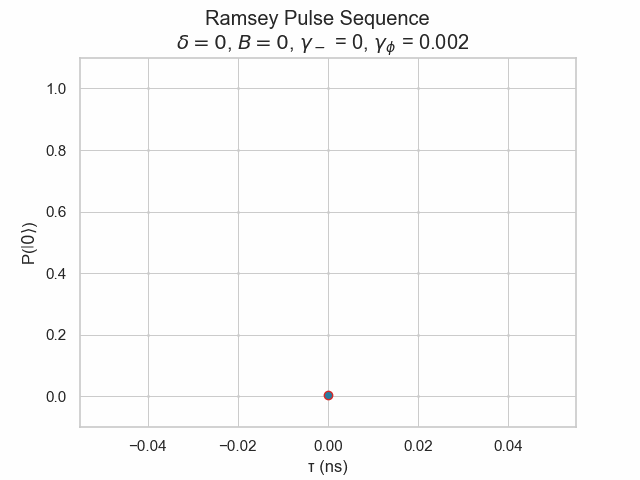

In [19]:
get_signal_graph('ramsey_graph_case_1.gif')

#### 3.2 No detuning, long $T_2$ times (weaker dephasing)

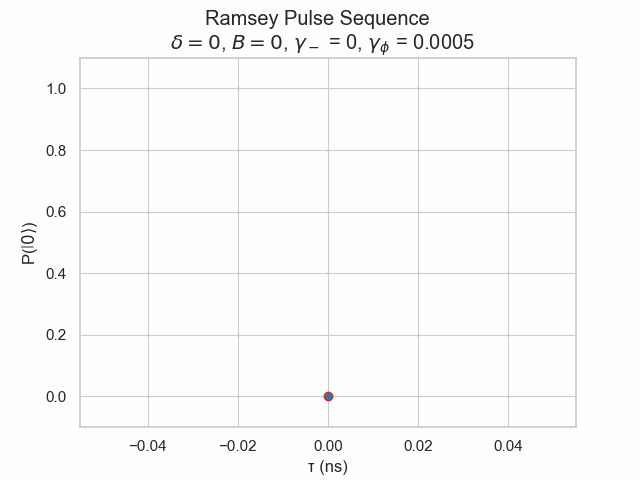

In [20]:
get_signal_graph('ramsey_graph_case_2.gif')

#### 3.3 Moderate detuning, short $T_2$ times (pure dephasing)

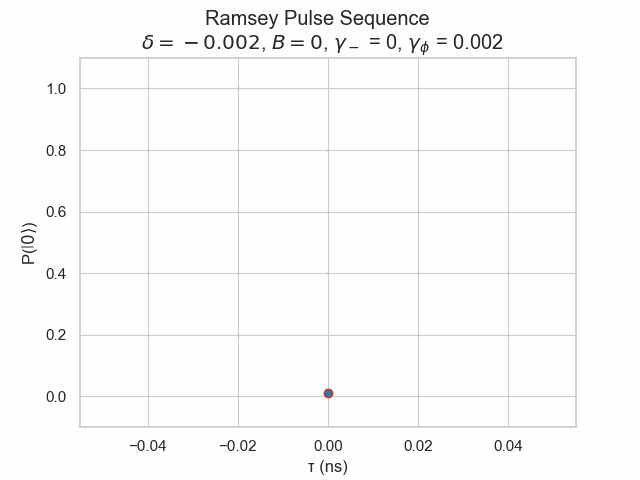

In [21]:
get_signal_graph('ramsey_graph_case_3.gif')

#### 3.4 Moderate detuning, long $T_2$ times (weaker dephasing)

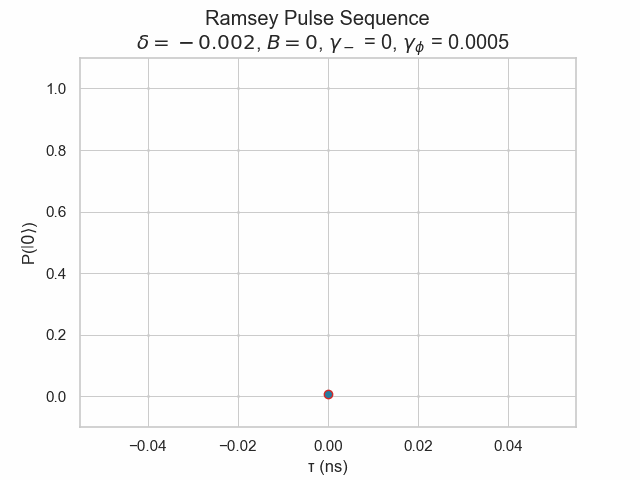

In [22]:
get_signal_graph('ramsey_graph_case_4.gif')

#### 3.5 External field only ($B > 0$)

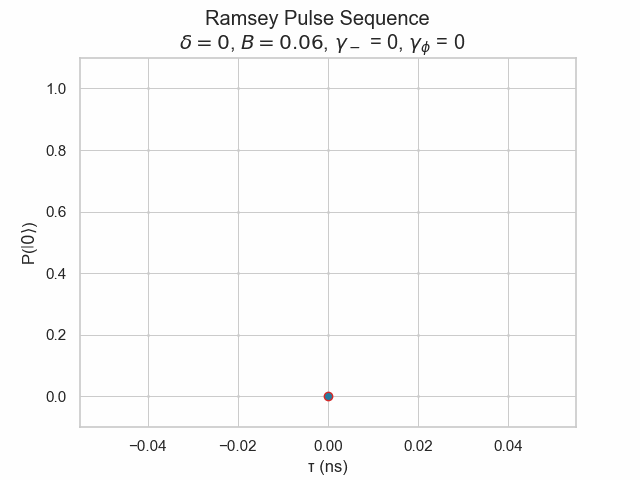

In [23]:
get_signal_graph('ramsey_graph_case_5.gif')

#### 3.6 $T_1$ relaxation and dephasing

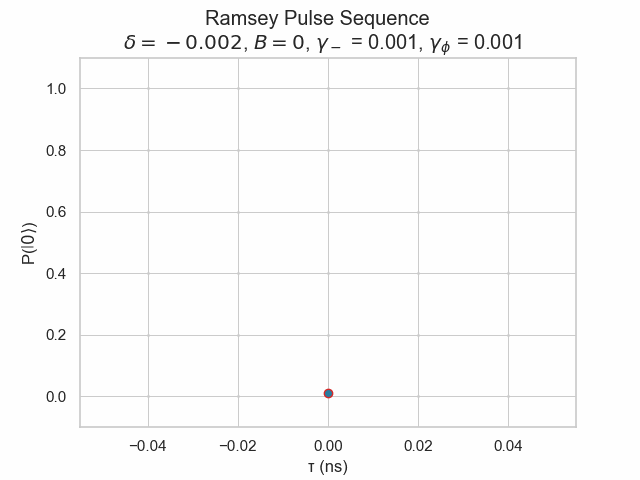

In [24]:
get_signal_graph('ramsey_graph_case_6.gif')

#### 3.7 With external field, $T_1$ relaxation and dephasing

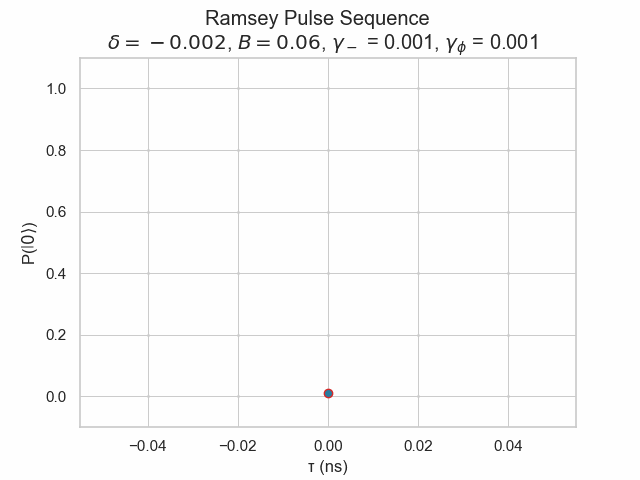

In [25]:
get_signal_graph('ramsey_graph_case_7.gif')

In the absence of no detuning and pure dephasing, as shown in 3.1, the qubit experiences coherent evolution during free precession time. The probability of the qubit in ground state $\ket{0}$ remains constant after the second $\frac{\pi}{2}$ pulse, equal to 0.5 since the system remains in a balanced superposition. In the same cases without detuning but slightly weaker dephasing, the probability of $\ket{0}$ reached 0.5 much longer as shown in 3.2. This indicates that $T_2$ values lead to faster decay of oscillation. 

By introducing detuning to the system, this leads to phase accumulation during the free evolution. The probability of measuring the system in the ground state exhibits an oscillatory (sinusoidal) patterns whose frequency corresponds to the detuning magnitude. As shown in 3.3 and 3.4, the oscillation decays faster for stronger dephasing and decays slower for weaker dephasing.

Application of a DC magnetic field alters the qubit's transition frequency via the Zeeman effect. When the system is only under magnetic field B, the rapid oscillation between ground state $\ket{0}$ and excited state $\ket{1}$ can be observed as shown in 3.5. This oscillation persists and does not decay until the dephasing is introduced to the system as shown in 3.6 and 3.7.

This simulation demonstrates the influence of $T_2$ coherence times on the rate of oscillation decay. Specifically, shorter $T_2$ times, corresponding to stronger dephasing, lead to a more rapid attenuation of the oscillations, whereas longer $T_2$ times, indicating weaker dephasing, result in a slower decay of the signal.

### Hahn-Echo Simulation

The standard Hahn-Echo protocol consists of an initial $\frac{\pi}{2}$ pulse, a free evolution period $\tau$, a $\pi$-pulse to invert the quantum state, followed by another free evolution, and finally a measurement. The key feature of Hahn-Echo simulation is its ability to reverse the accumulation of phase errors caused by low-frequency environmental noise. In an ideal noiseless environment, the final pulse restores the qubit to its original states. However, in the precense of dynamic fluctuations such as oscillating AC fields or dephasing, this refocusing becomes imperfect. Through this simulation, the behavior of Hahn-Echo signal under different conditions is investigated. These conditions includes setting different frequency, AC magnetic fields and dephasing in the system.

#### 4.1 No AC field, no dephasing

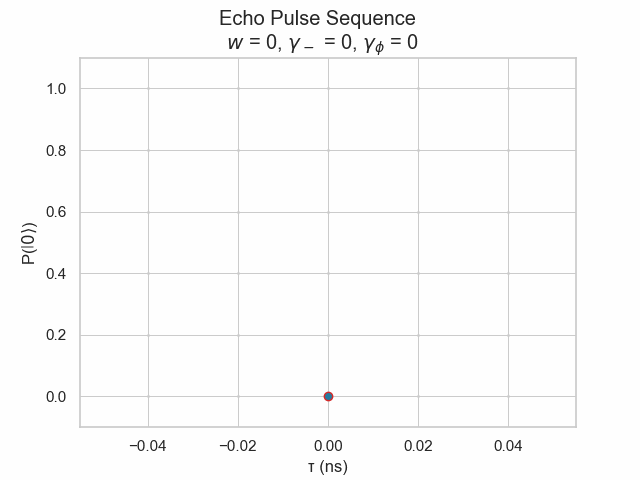

In [26]:
get_signal_graph('echo_graph_case_1.gif')

#### 4.2 AC field (low frequency, weak amplitude), no dephasing

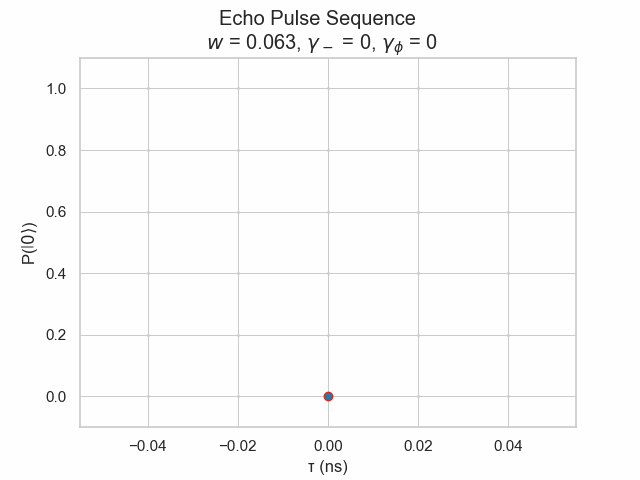

In [27]:
get_signal_graph('echo_graph_case_2.gif')

#### 4.3 AC field (high frequency, weak amplitude)

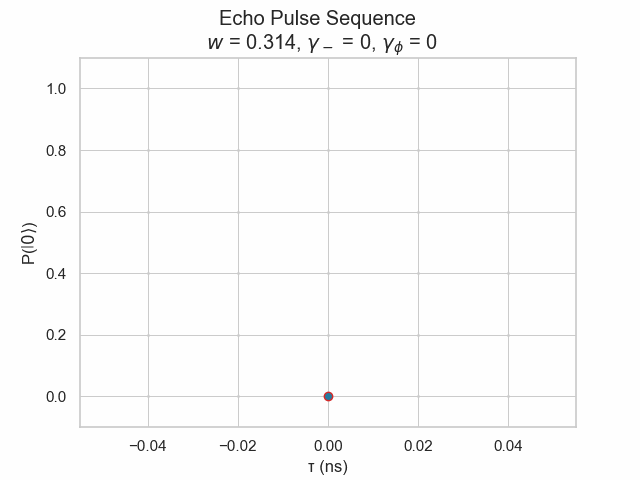

In [28]:
get_signal_graph('echo_graph_case_3.gif')

#### 4.4 AC field (low frequency), short $T_2$ times

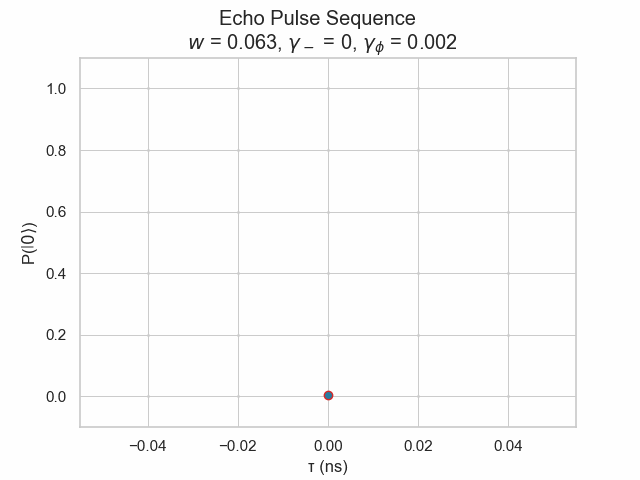

In [29]:
get_signal_graph('echo_graph_case_4.gif')

#### 4.5 AC field (high frequency), long $T_2$ times

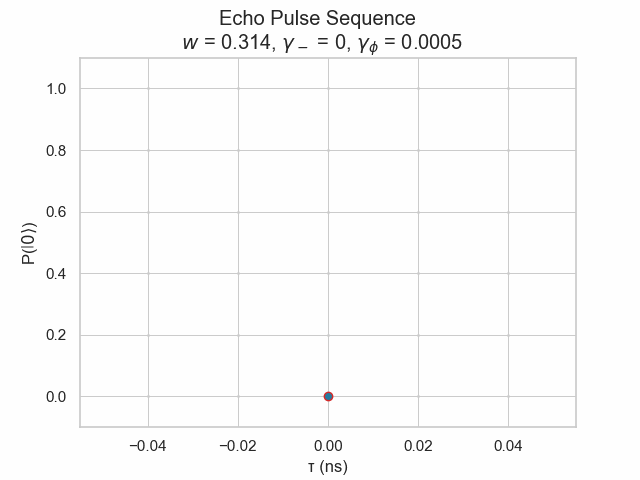

In [30]:
get_signal_graph('echo_graph_case_5.gif')

#### 4.6 No AC field, short $T_2$ times

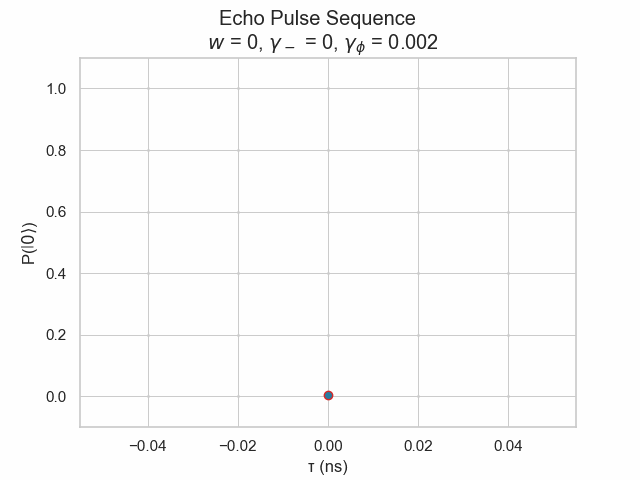

In [31]:
get_signal_graph('echo_graph_case_6.gif')

#### 4.7 No AC field, long $T_2$ times

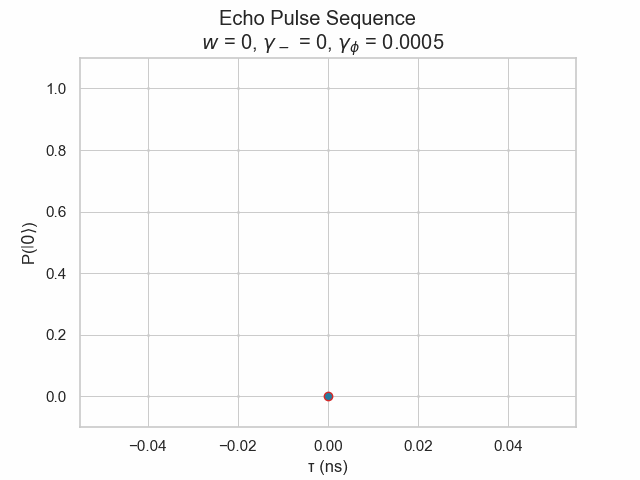

In [32]:
get_signal_graph('echo_graph_case_7.gif')

#### 4.8 Moderate AC field, moderate $T_2$ times

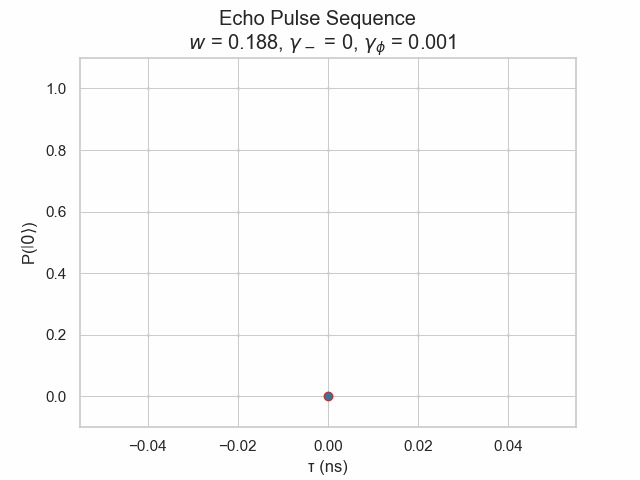

In [33]:
get_signal_graph('echo_graph_case_8.gif')

#### 4.9 Strong AC field, short T2

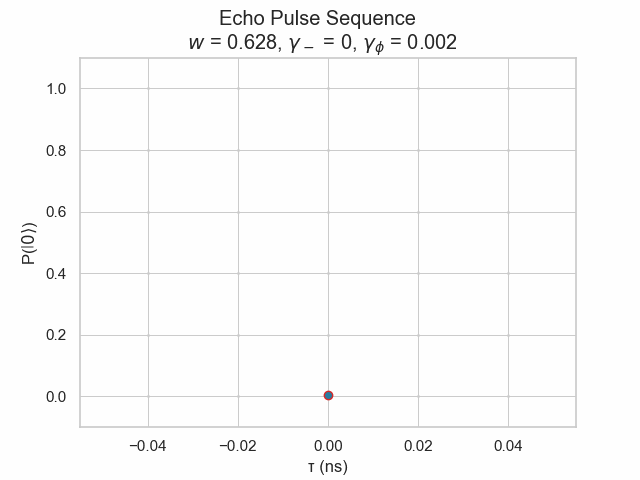

In [34]:
get_signal_graph('echo_graph_case_9.gif')

In the case where there is no applied AC field and no dephasing present, the Hahn-Echo signal remains constant around 0 as shown in 4.1, indicating that the system maintains maximum coherence preservation. This suggests that, under this ideal condition, the qubit phase's coherence is perfectly preserved, and no external perturbations are affecting the system.

When the low-frequency AC field is introduced in 4.2, the system exhibits rapid oscillations, reflecting the qubit's interaction with the low-frequency oscillating field, which causes periodic changes in the phase of the qubit. On the other hand, for higher frequency AC field, the system ceases to show oscillatory behavior as shown in 4.3.

Upon introducing dephasing into the system, the signal begins to decay towards 0.5, reflecting the loss of coherence due to interaction with the environment. For systems with low-frequency AC field and dephasing (4.4), the behavior is similar to the previous case in 4.2: the Echo signal exhibits rapid oscillation before decaying towards 0.5. In contrast, when a high-frequency AC field is present (4.5), the oscillation becomes slower, and the system decays more gradually, eventually reaching the steady-state value of 0.5.

When the system is only influenced by dephasing (with no AC field), the Echo signal does not exhibit any oscillations but simply decays monotonically towards 0.5 as shown in 4.6. In the same cases but with longer $T_2$ times in 4.7, the signal shows a slower decays. For moderate AC field applied to the system with a short $T_2$ times, the Hahn-echo signal exhibits oscillatory behavior as shown in 4.8. However, when the system is subjected to a stronger AC field, the behavior changes significantly. Rather than exhibiting oscillations, the echo signal fails to oscillate and instead decay monotonically as shown in 4.9.

Based on this result, shorter $T_2$ times causes the system to decay faster compared to longer $T_2$ times, consistent with the result obtained from Ramsey simulation.